# Load Image
---
### 1. Get the images of chesseboard picture taken from various angles. Images will be used to measure calibrations


In [5]:
import os
import cv2
import numpy as np
import matplotlib.pylab as plt
import matplotlib as mpl
%matplotlib inline
img_lst = os.listdir('camera_cal')
print('Number of images in camer_cal files',len(img_lst))
plt.figure(figsize=(200,200))
for i,x in enumerate(img_lst): 
    x = './camera_cal'+'/' + x
    img = cv2.imread(x)
    plt.subplot(4,5,i + 1)
    plt.imshow(img)
plt.tight_layout()

Number of images in camer_cal files 20


### 2. Road images that will be used for lane detection. 

In [40]:
road_img_lst = os.listdir('test_images')
print('Number of images in test_images files',len(img_lst))
plt.figure(figsize=(200,200))
for i,x in enumerate(img_lst): 
    x = './test_images'+'/' + x
    img = cv2.imread(x)
    plt.subplot(4,2,i + 1)
    plt.imshow(img)
plt.tight_layout()

Number of images in camer_cal files 8


# Pipeline steps
---
### 1. Find corners from cheese board.
* Get the corners form images to compute corners from images. 
* This corners will be used for camera calibration in next steps.

In [3]:
import os 
import numpy as np
import cv2
import pandas as pd
import matplotlib.pylab as plt
import matplotlib as mpl
%matplotlib inline

In [4]:
img_lst = os.listdir('camera_cal')
images = [ cv2.imread('./camera_cal/' + x )for x in img_lst]
objpoints = []   # Coordinates in 3D spaces. 
imgpoints = []   # Coordinates in 2D spaces. 
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2) #grid of objectpoints coordinate making z coordinate 0 

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
for image in images: 
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret,corners = cv2.findChessboardCorners(gray, (9,6), None)
    if ret: 
        objpoints.append(objp)
        imgpoints.append(corners)


### 2. Calculate distortion coefficient and Camera matrix to get undistorted image. 
* Using calcualted camera matrix and distortion coefficient from above steps we can get a undistorted image

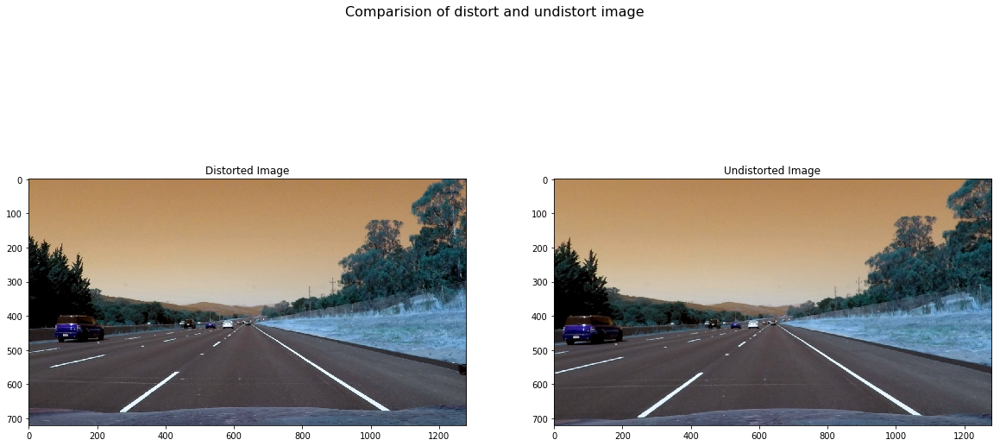

In [5]:
road_img_lst = os.listdir('test_images')
road_images = [ cv2.imread('./test_images/' + x )for x in road_img_lst]
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, road_images[1].shape[-2::-1],None,None)
undistorted_road = cv2.undistort(road_images[1],mtx,dist,None,mtx)
fig, axarr = plt.subplots(1, 2,figsize= (20,10))
fig.suptitle("Comparision of distort and undistort image", fontsize=16)
axarr[0].imshow(road_images[1])
axarr[0].set_title('Distorted Image')
axarr[1].imshow(undistorted_road)
axarr[1].set_title('Undistorted Image')


### 3. Threshold images.  
* There are 4 kind of thresh-holding techniques to detect line on the road were used. 
* (1) Calculate the derivative of image in horizontal or vertical  direction and find the area of image that meet certain threshold of threshold.
* (2) Calculate overall magnitude of gradient and find the area that meet certain threshold. 
* (3) Calculate the direction of the gradient by arctangent of ygradient and xgradient and find the area that meet certain threshold. 
* (4) Convert color space of image from RBG to HLS and find the area of image that meet certain threshold of saturation. 

In [ ]:
[((hue_binary ==1)&(sat_binary == 1))| ((gradx == 1) & (grady == 1))|((mag_binary == 1) & (dir_binary ==1))]

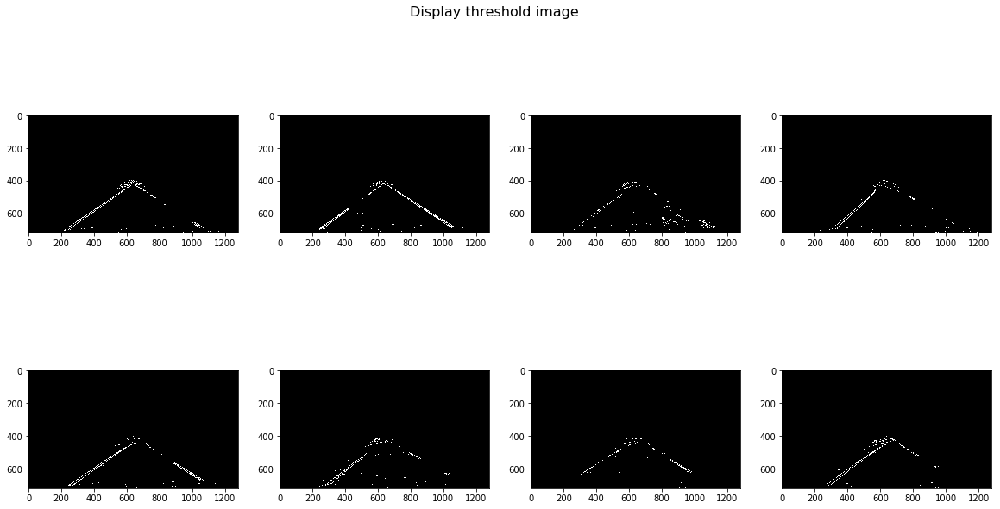

In [6]:
def region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)  
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
        
 
    else:
        ignore_mask_color = 255
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    
    cv2.fillPoly(mask, [vertices], ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask) 
    return masked_image

def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    if orient == 'x': 
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1,0,sobel_kernel))
    else: 
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0,1,sobel_kernel))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    grad_mask = np.zeros_like(scaled_sobel)
    grad_mask[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return grad_mask


def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1,0, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0,1, sobel_kernel)
    mag_img = np.sqrt(np.square(sobelx) + np.square(sobely))
    mag_scaled = np.uint8( 255 * mag_img / np.max(mag_img))
    mag_mask = np.zeros_like(mag_scaled)
    mag_mask[(mag_scaled >= mag_thresh[0]) & (mag_scaled <= mag_thresh[1])] = 1
    return mag_mask

def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1,0, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0,1, sobel_kernel)
    gradient_direction = np.arctan2(sobely, sobelx)
    direction_binary = np.zeros_like(gradient_direction)
    direction_binary[(gradient_direction >= thresh[0]) & (gradient_direction <= thresh[1])] = 1
    return direction_binary


def hls_thresh(img, s_thresh=(100, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    return binary_output

def hue_thresh(img, h_thresh=(10, 55)):
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    h_channel = hls[:,:,0]
    binary_output = np.zeros_like(h_channel)
    binary_output[(h_channel <= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    return binary_output



def pipeline(img,verticies):
    ksize= 21
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    l_channel = hls[:,:,1]
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(10, 255))
    gradx = region_of_interest(gradx,verticies)
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(30, 255))
    grady = region_of_interest(grady,verticies)
    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(80, 255))
    mag_binary = region_of_interest(mag_binary,verticies)
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(2.1, 2.6))
    sat_binary = hls_thresh(img, s_thresh=(195, 235))
    sat_binary = region_of_interest(sat_binary,verticies)
    combined = np.zeros_like(sat_binary)
    combined[ ((sat_binary  == 1))|((mag_binary == 1) & (dir_binary == 1))|((gradx ==1)&(grady==1))] = 1
    return combined

fig, axarr = plt.subplots(2, 4,figsize= (20,10))
top_left = [600,400]
top_right = [650,400]
bottom_left = [200,720]
bottom_right = [1200,720]
verticies = np.asarray([top_left,top_right,bottom_right,bottom_left])
for idx,img in enumerate(road_images): 
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    combined = pipeline(undistorted,verticies)
    fig.suptitle("Display threshold image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(combined,cmap = 'gray')
    else:
        axarr[1,idx - 4].imshow(combined,cmap = 'gray')

plt.show()


In [ ]:
|((gradx == 1) & (grady == 1))|((mag_binary == 1) & (dir_binary ==1))

In [ ]:
((gradx == 1) & (grady == 1))|((mag_binary == 1) & (dir_binary ==1))

### 3. Warp transformation. 
* Transform image to get a bird eye view of the road to make lane detection with parerall lines. 
* We can determine manually the source point and destination point for warp transformation by visualizing image. 

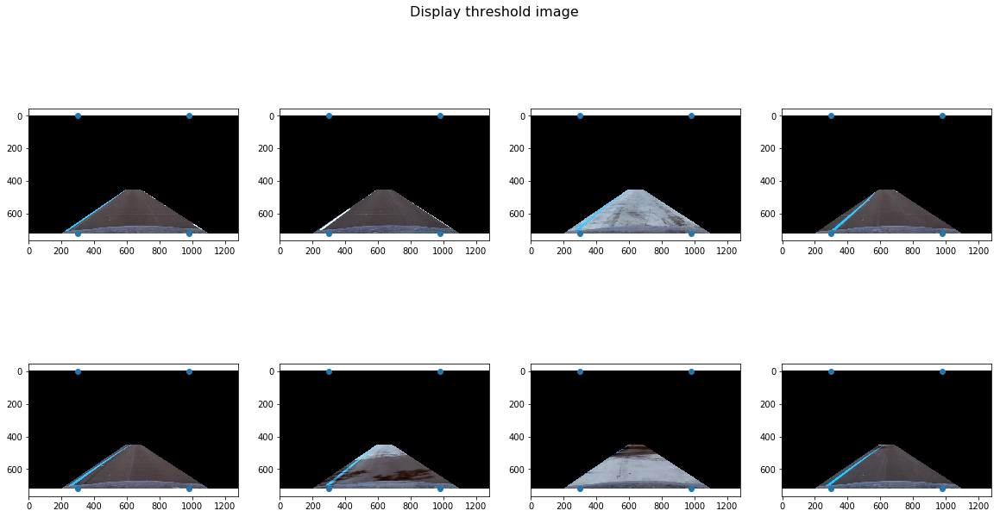

In [7]:


def perspective_transform(road_img,src,dst,mtx,dist):
    img_size  = (road_img.shape[1], road_img.shape[0])
    #undistorted = cv2.undistort(road_img,mtx,dist,None,mtx)
    offset = 100
    M = cv2.getPerspectiveTransform(src,dst)
    warped = cv2.warpPerspective(road_img,M,img_size,flags = cv2.INTER_LINEAR)
    return warped, M

top_left = [595,450]
top_right = [685,450]
bottom_left = [200,720]
bottom_right = [1100,720]
src = np.asarray([top_left,top_right,bottom_right,bottom_left])
#src = np.float32(src)
top_left = [300,0]
top_right = [980,0]
bottom_left = [300,720]
bottom_right = [980,720]
dst = np.float32([top_left,top_right,bottom_right,bottom_left])

fig, axarr = plt.subplots(2, 4,figsize= (20,10))

for idx,img in enumerate(road_images): 
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    interest_img = region_of_interest(undistorted,src)
    fig.suptitle("Display threshold image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(interest_img)
        axarr[0,idx].scatter(dst[:,0],dst[:,1])
    else:
        axarr[1,idx - 4].imshow(interest_img)
        axarr[1,idx - 4].scatter(dst[:,0],dst[:,1])


plt.show()
src = np.float32(src)



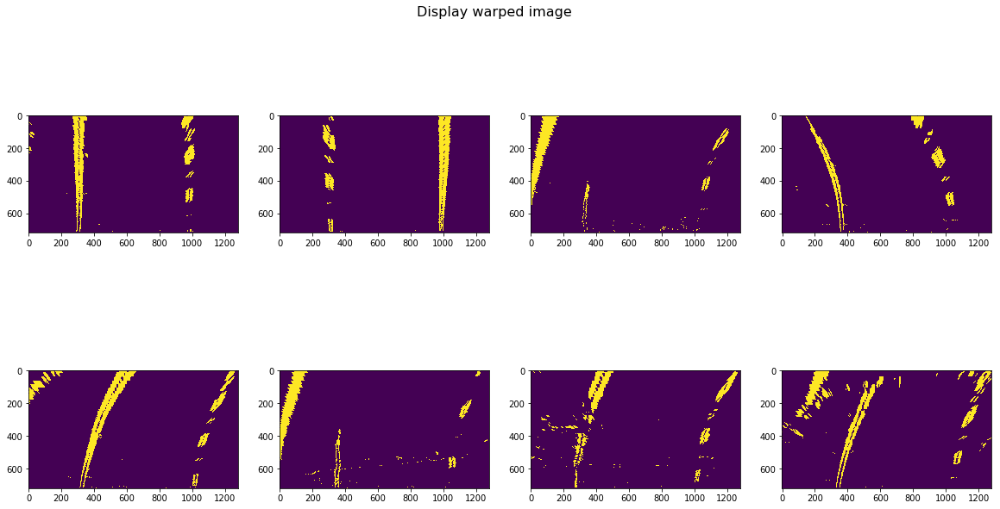

In [8]:

fig, axarr = plt.subplots(2, 4,figsize= (20,10))

for idx,img in enumerate(road_images): 
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    top_left = [500,400]
    top_right = [700,400]
    bottom_left = [150,720]
    bottom_right = [1150,720]
    verticies = np.asarray([top_left,top_right,bottom_right,bottom_left])
    combined = pipeline(undistorted,verticies)
    warped,M = perspective_transform(combined,src,dst,mtx,dist)
    fig.suptitle("Display warped image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(warped)
    else:
        axarr[1,idx - 4].imshow(warped)

plt.show()



### 5. Finding Centroids from the image to be used for connecting lines. 
* (1) Divide the image area by pre-defined window size. 
* (2) As we slide the window by each level find the point where value of linear convolution between vertical slice of image in the window and window_width vector become maximized. 
* (3) From the centroids point we calculate the y_point value on each side of lane.

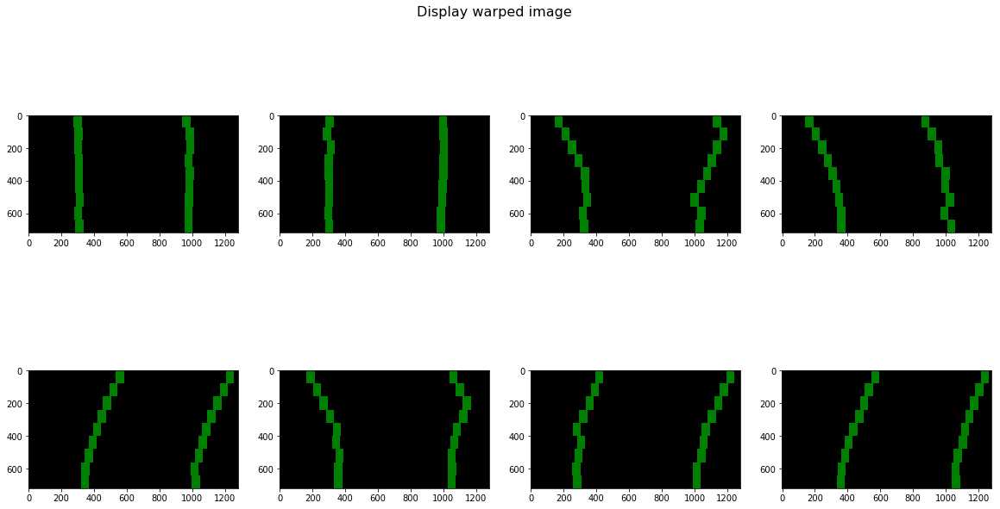

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import cv2


window_width = 50 
window_height = 80 # By setting window height to 80 we can verify that our lane image is dvided into 9 slices. 
margin = 40 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    height_start = int(img_ref.shape[0]-(level+1)*height)
    height_end = int(img_ref.shape[0]-level*height)
    output[height_start:height_end,max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1

    return output

def find_window_centroids(combined, window_width, window_height, margin):
    
    window_centroids = [] 
    y_points = []
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    #Get the initial centroid by using 1/4 part of image. 
    left_combined = np.zeros_like(combined)
    right_combined = np.zeros_like(combined)
    left_combined[int(3*combined.shape[0]/4):,:int(combined.shape[1]/2)] = 1
    right_combined[int(3*combined.shape[0]/4):,int(combined.shape[1]/2):] = 1
    
    l_sum = np.sum(combined[int(3*combined.shape[0]/4):,:int(combined.shape[1]/2)], axis=0) 
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(combined[int(3*combined.shape[0]/4):,int(combined.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(combined.shape[1]/2)
    
    left_y = np.argwhere(left_combined[:,int(l_center)])
    left_y = left_y[int(len(left_y)/2)][0]
    right_y = np.argwhere(right_combined[:,int(r_center)])
    right_y = right_y[int(len(right_y)/2)][0]
    window_centroids.append((l_center,r_center))
    y_points.append((left_y,right_y))
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(combined.shape[0]/window_height)):
        empty_combined = np.zeros_like(combined)
        empty_combined[int(combined.shape[0]-(level+1)*window_height):int(combined.shape[0]-level*window_height),:] = 1
        
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(combined[int(combined.shape[0]-(level+1)*window_height):int(combined.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,combined.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset

        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,combined.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        
        
        left_y = np.argwhere(empty_combined[:,int(l_center)])
        left_y = left_y[int(len(left_y)/2)][0]
        right_y = np.argwhere(empty_combined[:,int(r_center)])
        right_y = right_y[int(len(right_y)/2)][0]
        window_centroids.append((l_center,r_center))
        y_points.append((left_y,right_y))

    return window_centroids,y_points


def draw_centroid_img(warped,window_centoriods):
    # If we found any window centers
    if len(window_centroids) > 0:
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
     # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)
    return output

# Display the final results
fig, axarr = plt.subplots(2, 4,figsize= (20,10))

for idx,img in enumerate(road_images): 
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    combined = pipeline(undistorted,verticies)
    warped,M = perspective_transform(combined,src,dst,mtx,dist)
    window_centroids,y_points = find_window_centroids(warped, window_width, window_height, margin)
    output = draw_centroid_img(warped,window_centroids)
    fig.suptitle("Display warped image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(output)
    else:
        axarr[1,idx - 4].imshow(output)

plt.show()

### 6. Fit the lane. 
* (1) Fit the left and right lane respectively by using x,y value of the pixels that we gained on previous step. 
* (2) Based on the coefficent of 2nd polynomial calculate the radius of curvature. 
    * We can verify that the straight lane return bigger radius of curvature while curved lane return small curvature. 
    * It lead to great difference between right and left radius value although the lane detected correctly. 

In [10]:

def return_poly_fit(y_points,x_points):
    fits = np.polyfit(y_points, x_points, 2)
    return fits

def calculate_curverad(y_points,x_points):
    #ploty = np.linspace(0, combined.shape[0]-1, combined.shape[0] )
    y_eval = 720
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    fit_cr = np.polyfit(y_points*ym_per_pix, x_points*xm_per_pix, 2)
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    return curverad


for idx,img in enumerate(road_images): 
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    combined = pipeline(undistorted,verticies)
    warped,M = perspective_transform(combined,src,dst,mtx,dist)
    window_centroids,y_points = find_window_centroids(warped, window_width, window_height, margin)
    left_x = np.asarray(window_centroids)[:,0]
    right_x = np.asarray(window_centroids)[:,1]
    left_y = np.asarray(y_points)[:,0]
    right_y = np.asarray(y_points)[:,1]
    print('maximum difference in x_position.',np.max(abs(left_x - right_x)))
    print('left curvread ','{}m'.format(calculate_curverad(left_y,left_x)))
    print('right curvread ','{}m'.format(calculate_curverad(right_y,right_x)))

    fig.suptitle("Display warped image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(output)
    else:
        axarr[1,idx - 4].imshow(output)

plt.show()


maximum difference in x_position. 684.0
left curvread  5025.543236042365m
right curvread  1311.9468808384104m
maximum difference in x_position. 711.0
left curvread  7908.89728232487m
right curvread  1576.5812033297195m
maximum difference in x_position. 965.0
left curvread  204.62309378738183m
right curvread  1443.5584241157378m
maximum difference in x_position. 708.0
left curvread  392.2119378256947m
right curvread  360.7939670496403m
maximum difference in x_position. 678.0
left curvread  601.5757275068652m
right curvread  513.1373202666733m
maximum difference in x_position. 873.0
left curvread  245.4962691923428m
right curvread  335.3057323348604m
maximum difference in x_position. 801.0
left curvread  335.89234737241276m
right curvread  461.8599900535128m
maximum difference in x_position. 702.0
left curvread  806.5726426036725m
right curvread  651.3304788088656m


### 7. Restore Original image with the area inside the lane are colored. 
* From the Functions from previous steps construct final pipeline
* When the lane detection didn't meet two specific condition we using detected line in beforehand. 
    * (1) When  minimum value radius of left and right curve smaller than 1000 and absoulte value of it's difference is higher than 1000. (It means radius show great difference although the lanes were not straight.
    * (2) When maximum distance between right x value and left x value exeed 850

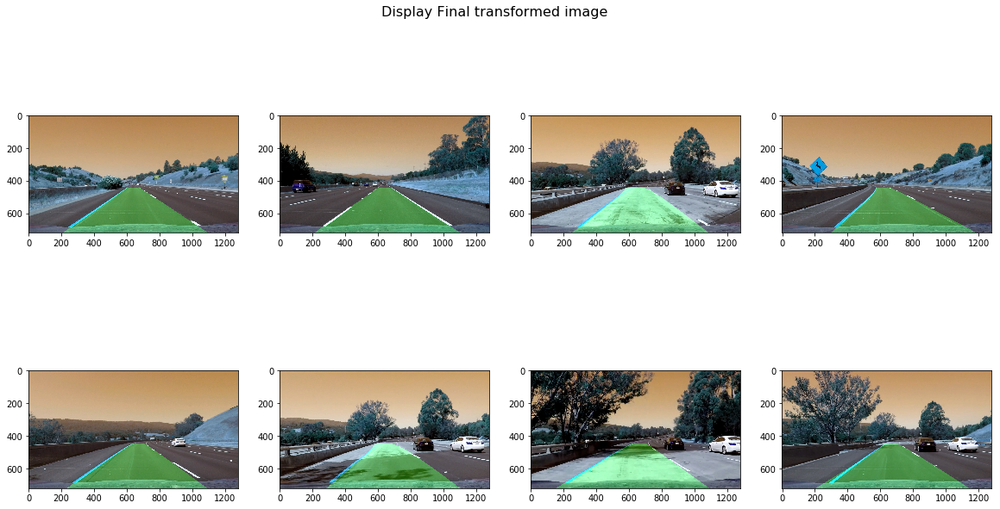

In [17]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        self.recent_xfitted = [] 
        self.recent_ypoint = []
        self.recent_coefficient = []
        self.recent_curverad = []
        self.recent_sanity_checked = False
        

    
def sanity_check(left_x, left_y, right_x, right_y,left_curverad, right_curverad):
    maximum_distance = np.max(abs(left_x - right_x))
    distance_cond = maximum_distance <= 850
    curverad_cond = ~((min(left_curverad,right_curverad) < 1000) &(abs(left_curverad - right_curverad) > 1000))
    return distance_cond & curverad_cond


def update_lane(x_point,y_point,curverad,lane,detected = False):
    lane.recent_xfitted = x_point
    lane.recent_ypoint = y_point
    lane.recent_coefficient = np.polyfit(y_point, x_point, 2)
    lane.recent_curverad = curverad
    lane.recent_sanity_checked = detected
    return lane


def draw_transformed_img(left_lane,right_lane,src,dst,combined,undistorted_road):
    left_fit = left_lane.recent_coefficient
    right_fit = right_lane.recent_coefficient
    ploty = np.linspace(0, combined.shape[0]-1, combined.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    warp_zero = np.zeros_like(combined).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undistorted_road.shape[1], undistorted_road.shape[0]))
    # Combine the result with the original image
    result = cv2.addWeighted(undistorted_road, 1, newwarp, 0.3, 0)
    return result


left_lane = Line()
right_lane = Line()
global left_lane,right_lane

def final_pipeline(img):
    objpoints = np.load('./objpoints.npy')
    objpoints = list(objpoints)
    imgpoints = np.load('./imgpoints.npy')
    imgpoints = list(imgpoints)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[-2::-1],None,None)
    undistorted = cv2.undistort(img,mtx,dist,None,mtx)
    combined = pipeline(undistorted,verticies)
    top_left = [585,450]
    top_right = [690,450]
    bottom_left = [255,660]
    bottom_right = [1050,660]
    src = np.asarray([top_left,top_right,bottom_right,bottom_left])
    src = np.float32(src)
    top_left = [255,100]
    top_right = [1050,100]
    bottom_left = [255,700]
    bottom_right = [1050,700]
    global left_lane,right_lane
    dst = np.float32([top_left,top_right,bottom_right,bottom_left])
    warped,M = perspective_transform(combined,src,dst,mtx,dist)
    window_centroids,y_points = find_window_centroids(warped,50,80,40)
    left_x = np.asarray(window_centroids)[:,0]
    right_x = np.asarray(window_centroids)[:,1]
    left_y = np.asarray(y_points)[:,0]
    right_y = np.asarray(y_points)[:,1]
    left_curverad = calculate_curverad(left_y, left_x)
    right_curverad = calculate_curverad(right_y,right_x)
    sanity_cond = sanity_check(left_x, left_y, right_x, right_y,left_curverad, right_curverad)
    if sanity_cond: 
        left_lane = update_lane(left_x,left_y,left_curverad,left_lane,True)
        right_lane = update_lane(right_x, right_y, right_curverad, right_lane, True)
    else: 
        if (~(left_lane.recent_sanity_checked)& ~(right_lane.recent_sanity_checked)):
            left_lane = update_lane(left_x,left_y,left_curverad,left_lane,False)
            right_lane = update_lane(right_x, right_y, right_curverad, right_lane,False)
        elif (left_lane.recent_sanity_checked) & ~(right_lane.recent_sanity_checked):
            sainty_cond = sanity_check(left_lane.recent_xfitted,left_lane.recent_ypoint, right_x, right_y,
                                       left_lane.curverad, right_curverad)
            right_lane = update_lane(right_x,right_y,right_curverad,right_lane,sanity_cond)
        elif (~(left_lane.recent_sanity_checked) & (right_lane.recent_sanity_checked)):
            sanity_cond = sanity_check(left_x,left_y, right_lane.recent_xfitted,right_lane.recent_ypoint,
                                      left_curverad, right_lane.curverad)
            left_lane = update_lane(left_x,left_y, left_curverad,left_lane, sanity_cond)
    result = draw_transformed_img(left_lane,right_lane,src,dst,warped,img)
    return result





fig, axarr = plt.subplots(2, 4,figsize= (20,10))

for idx,img in enumerate(road_images): 
    result = final_pipeline(img)
    fig.suptitle("Display Final transformed image", fontsize=16)
    if idx < 4:
        axarr[0,idx].imshow(result)
    else:
        axarr[1,idx - 4].imshow(result)

plt.show()


In [18]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML




yellow_output = 'first_try.mp4'
clip2 = VideoFileClip('project_video.mp4')
yellow_clip = clip2.fl_image(final_pipeline)
%time yellow_clip.write_videofile(yellow_output, audio=False)

[MoviePy] >>>> Building video first_try.mp4
[MoviePy] Writing video first_try.mp4


100%|█████████▉| 1260/1261 [13:27<00:00,  1.50it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: first_try.mp4 

CPU times: user 13min 48s, sys: 50.9 s, total: 14min 39s
Wall time: 13min 27s


In [14]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(yellow_output))